<a href="https://colab.research.google.com/github/AntoineDjeukeng/DMA/blob/master/F_comp.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<ipython-input-79-0899100b4e1d>:30: MatplotlibDeprecationWarning: Setting data with a non sequence type is deprecated since 3.7 and will be remove two minor releases later
  point.set_data(x, y)


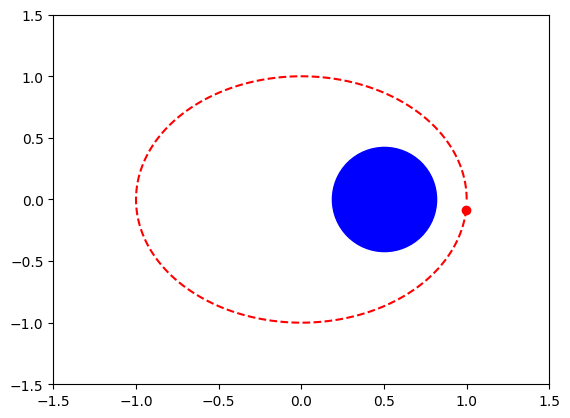

In [79]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Create a figure and axis
fig, ax = plt.subplots()
ax.set_xlim(-1.5, 1.5)
ax.set_ylim(-1.5, 1.5)

# Create a larger central particle (Earth)
central_particle, = ax.plot(0.5, 0, 'bo', markersize=75)

# Create a point (orbiting particle)
point, = ax.plot([], [], 'ro')

# Create a line for the trajectory
trajectory, = ax.plot([], [], 'r--')

# Initialization function for the animation
def init():
    point.set_data([], [])
    trajectory.set_data([], [])
    return point, trajectory,

# Animation function
def animate(frame):
    x = np.cos(np.radians(frame))  # Circular motion in x-direction
    y = np.sin(np.radians(frame))  # Circular motion in y-direction
    point.set_data(x, y)

    # Update trajectory
    trajectory.set_data(np.cos(np.radians(np.arange(0, frame, 1))), np.sin(np.radians(np.arange(0, frame, 1))))

    return point, trajectory,

# Create the animation
ani = FuncAnimation(fig, animate, frames=np.arange(0, 360, 5), init_func=init, blit=True)

# Display the animation
HTML(ani.to_jshtml())


<ipython-input-2-f00473b4c3a4>:54: MatplotlibDeprecationWarning: Setting data with a non sequence type is deprecated since 3.7 and will be remove two minor releases later
  lines[i].set_data(body.position[0], body.position[1])


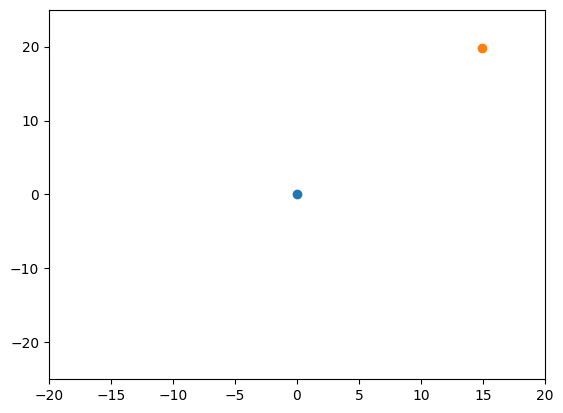

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML, display

class Body:
    def __init__(self, mass, position, velocity):
        self.mass = mass
        self.position = np.array(position, dtype=float)
        self.velocity = np.array(velocity, dtype=float)
        self.force = np.zeros(2, dtype=float)

    def calculate_gravitational_force(self, other_body, G=6.67430e-11):
        r = other_body.position - self.position
        distance = np.linalg.norm(r)
        force_magnitude = (G * self.mass * other_body.mass) / (distance ** 2)
        force_direction = r / distance
        gravitational_force = force_magnitude * force_direction
        return gravitational_force

    def update_position(self, dt):
        self.position += self.velocity * dt

    def update_velocity(self, dt):
        acceleration = self.force / self.mass
        self.velocity += acceleration * dt

# Example usage
body1 = Body(mass=100.0, position=[0, 0], velocity=[0,0])
body2 = Body(mass=2.0, position=[5, 0], velocity=[1, 2])
body3 = Body(mass=4.0, position=[5, 5], velocity=[2, 2])
bodies = [body1, body2, body3]

# Simulation parameters
dt = 0.1  # Time step

# Set up the figure and axis for the animation
fig, ax = plt.subplots()
ax.set_xlim(-20,20)
ax.set_ylim(-25, 25)

# Create lines for each body
lines = [ax.plot([], [], 'o')[0] for _ in bodies]

# Initialization function for the animation
def init():
    for line in lines:
        line.set_data([], [])
    return lines

# Animation function
def animate(frame):
    for i, body in enumerate(bodies):
        lines[i].set_data(body.position[0], body.position[1])

    for body in bodies:
        for other_body in bodies:
            if body != other_body:
                force = body.calculate_gravitational_force(other_body)
                body.force += force

        body.update_position(dt)
        body.update_velocity(dt)

    return lines

# Create the animation
ani = FuncAnimation(fig, animate, frames=100, init_func=init, blit=True)

# Display the animation
display(HTML(ani.to_jshtml()))


In [ ]:
import numpy as np

class Body:
    def __init__(self, mass, position, velocity):
        self.mass = mass
        self.position = np.array(position, dtype=float)
        self.velocity = np.array(velocity, dtype=float)
        self.force = np.zeros(2, dtype=float)

    def calculate_gravitational_force(self, other_body, G=6.67430e-11):
        # Calculate the gravitational force between this body and another body
        r = other_body.position - self.position
        distance = np.linalg.norm(r)
        force_magnitude = (G * self.mass * other_body.mass) / (distance ** 2)
        force_direction = r / distance
        gravitational_force = force_magnitude * force_direction
        return gravitational_force

    def update_position(self, dt):
        # Update position based on current velocity and time step
        self.position += self.velocity * dt

    def update_velocity(self, dt):
        # Update velocity based on current force and time step
        acceleration = self.force / self.mass
        self.velocity += acceleration * dt

# Example usage
# Create two bodies
body1 = Body(mass=1.0, position=[0, 0], velocity=[1, 0])
body2 = Body(mass=2.0, position=[5, 0], velocity=[1, 0])
body3 = Body(mass=100.0, position=[5, 5], velocity=[0, 0])
# List of bodies
bodies = [body1, body2, body3 ]

# Simulation parameters
dt = 0.1  # Time step

# Simulation loop
for _ in range(10):
    # Reset forces for each body
    for body in bodies:
        body.force = np.zeros(2)

    # Calculate gravitational forces between all pairs of bodies
    for i in range(len(bodies)):
        for j in range(i + 1, len(bodies)):
            force_i = bodies[i].calculate_gravitational_force(bodies[j])
            force_j = -force_i  # By Newton's third law
            bodies[i].force += force_i
            bodies[j].force += force_j

    # Update positions and velocities of each body
    for body in bodies:
        body.update_position(dt)
        body.update_velocity(dt)

    # Print the final positions and velocities of the bodies
    for i, body in enumerate(bodies):
        print(f"Body {i + 1}:")
        print("Position:", body.position)
        print("Velocity:", body.velocity)


Body 1:
Position: [0.1 0. ]
Velocity: [1.00000000e+00 9.43888558e-12]
Body 2:
Position: [5.1 0. ]
Velocity: [1.00000e+00 2.66972e-11]
Body 3:
Position: [5. 5.]
Velocity: [-9.43888558e-14 -6.28332856e-13]
Body 1:
Position: [2.00000000e-01 9.43888558e-13]
Velocity: [1.00000000e+00 1.91652083e-11]
Body 2:
Position: [5.20000e+00 2.66972e-12]
Velocity: [1.00000000e+00 5.33783897e-11]
Body 3:
Position: [5. 5.]
Velocity: [-1.79034342e-13 -1.25921988e-12]
Body 1:
Position: [3.00000000e-01 2.86040939e-12]
Velocity: [1.00000000e+00 2.91875967e-11]
Body 2:
Position: [5.30000000e+00 8.00755897e-12]
Velocity: [1.00000000e+00 8.00116443e-11]
Body 3:
Position: [5. 5.]
Velocity: [-2.53942667e-13 -1.89210885e-12]
Body 1:
Position: [4.00000000e-01 5.77916905e-12]
Velocity: [1.00000000e+00 3.95147992e-11]
Body 2:
Position: [5.40000000e+00 1.60087234e-11]
Velocity: [1.00000000e+00 1.06565325e-10]
Body 3:
Position: [5. 5.]
Velocity: [-3.19153953e-13 -2.52645450e-12]
Body 1:
Position: [5.00000000e-01 9.7306

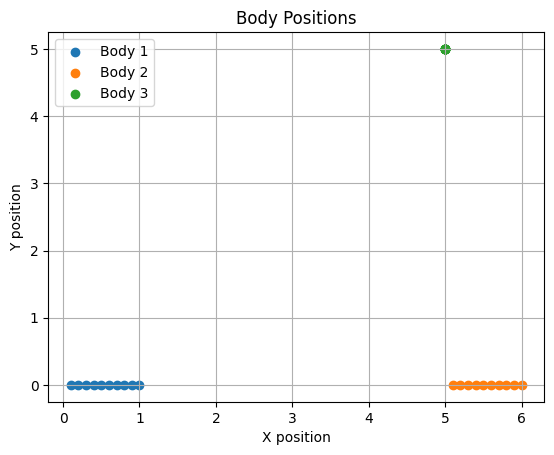

In [ ]:
import numpy as np

class Body:
    def __init__(self, mass, position, velocity):
        self.mass = mass
        self.position = np.array(position, dtype=float)
        self.velocity = np.array(velocity, dtype=float)
        self.force = np.zeros(2, dtype=float)

    def calculate_gravitational_force(self, other_body, G=6.67430e-11):
        # Calculate the gravitational force between this body and another body
        r = other_body.position - self.position
        distance = np.linalg.norm(r)
        force_magnitude = (G * self.mass * other_body.mass) / (distance ** 2)
        force_direction = r / distance
        gravitational_force = force_magnitude * force_direction
        return gravitational_force

    def update_position(self, dt):
        # Update position based on current velocity and time step
        self.position += self.velocity * dt

    def update_velocity(self, dt):
        # Update velocity based on current force and time step
        acceleration = self.force / self.mass
        self.velocity += acceleration * dt

# Example usage
# Create two bodies
body1 = Body(mass=1.0, position=[0, 0], velocity=[1, 0])
body2 = Body(mass=2.0, position=[5, 0], velocity=[1, 0])
body3 = Body(mass=100.0, position=[5, 5], velocity=[0, 0])
# List of bodies
bodies = [body1, body2, body3]

# Simulation parameters
dt = 0.1  # Time step

# Lists to store positions for plotting
x_positions = [[] for _ in bodies]
y_positions = [[] for _ in bodies]

# Simulation loop
for _ in range(10):
    # Reset forces for each body
    for body in bodies:
        body.force = np.zeros(2)

    # Calculate gravitational forces between all pairs of bodies
    for i in range(len(bodies)):
        for j in range(i + 1, len(bodies)):
            force_i = bodies[i].calculate_gravitational_force(bodies[j])
            force_j = -force_i  # By Newton's third law
            bodies[i].force += force_i
            bodies[j].force += force_j

    # Update positions and velocities of each body
    for i, body in enumerate(bodies):
        body.update_position(dt)
        body.update_velocity(dt)
        x_positions[i].append(body.position[0])
        y_positions[i].append(body.position[1])

# Plotting the positions of the bodies
plt.figure()
for i in range(len(bodies)):
    plt.scatter(x_positions[i], y_positions[i], label=f'Body {i+1}')
plt.xlabel('X position')
plt.ylabel('Y position')
plt.title('Body Positions')
plt.legend()
plt.grid(True)
plt.show()

# # Print the final positions and velocities of the bodies
# for i, body in enumerate(bodies):
#     print(f"Body {i + 1}:")
#     print("Position:", body.position)
#     print("Velocity:", body.velocity)


In [ ]:

rewrite it and make it work normaly

import numpy as np  # Assuming you'll use NumPy for vector operations

# Define the nor() function to calculate the magnitude of a vector
def nor(vector):
    return np.linalg.norm(vector)

# Define the Particle class
class Particle:
    def __init__(self, ml, Al, Fl, Vl):
        self.ml = ml
        self.Al = Al
        self.Fl = Fl
        self.Vl = Vl
        self.rl = self.calculate_rl()
        self.Thet = self.calculate_Thet()

    def calculate_rl(self):
        return nor(self.Al)

    def calculate_Thet(self):
        return np.arccos(self.Al[0] / self.rl)
ml_values = np.random.rand(23)  # Replace this with your actual mass values
Al_values = np.random.rand(23, 2)  # Replace this with your actual Al values (a 2D array for 3D coordinates)
Fl_values = np.random.rand(23, 2)  # Replace this with your actual Fl values (a 2D array for 3D coordinates)
Vl_values = np.random.rand(23,2)  # Replace this with your actual Vl values (a 2D array for 3D coordinates)



# Assuming N is defined earlier in your code
N = 23
particles = [Particle(ml_values[i], Al_values[i], Fl_values[i], Vl_values[i]) for i in range(N)]
def calculate_center_of_mass(particles):
    total_mass = sum(p.ml for p in particles)
    center_of_mass = np.zeros(2)  # Initialize center of mass vector [x, y, z]

    for p in particles:
        # Weighted sum of positions
        center_of_mass += p.ml * p.Al

    # Divide by total mass to get the center of mass
    center_of_mass /= total_mass

    return center_of_mass

# Calculate the center of mass
center_of_mass = calculate_center_of_mass(particles)
print("Center of Mass:", center_of_mass)

import numpy as np

# Assuming you have defined the necessary functions and variables

def update_characteristics(particles, t):
    for k in range(len(particles)):
        Fk = np.zeros(3)  # Initialize force for each particle k
        for l in range(len(particles)):
            if l != k:
                # Update Fk using the provided formula
                Fk += (-Vec(OAk) * sum(ml)) / np.abs(Vec(OAl) - Vec(OAk)) + mk * sum(Vec(OAl)) / np.abs(Vec(OAl) - Vec(OAk))

        # Update Thet(Pl) and rl for particle k
        particles[k].Thet = nor(particles[k].Vl) ** 3 * t / nor(particles[k].Fl) + particles[k].Thet
        particles[k].rl = nor(particles[k].Fl) / (nor(particles[k].Vl) ** 3)

# Define the parameter t
t = 0.1

# Call the update function 500 times
for _ in range(500):
    update_characteristics(particles, t)

    # Print the coordinates of each particle
    for i, particle in enumerate(particles):
        print(f"Particle {i + 1} Coordinates:", particle.Al)

In [ ]:
ml_values = np.random.rand(23)  # Replace this with your actual mass values
Al_values = np.random.rand(23, 2)  # Replace this with your actual Al values (a 2D array for 3D coordinates)
Fl_values = np.random.rand(23, 2)  # Replace this with your actual Fl values (a 2D array for 3D coordinates)
Vl_values = np.random.rand(23,2)  # Replace this with your actual Vl values (a 2D array for 3D coordinates)



# Assuming N is defined earlier in your code
N = 23
particles = [Particle(ml_values[i], Al_values[i], Fl_values[i], Vl_values[i]) for i in range(N)]



In [ ]:
def calculate_center_of_mass(particles):
    total_mass = sum(p.ml for p in particles)
    center_of_mass = np.zeros(2)  # Initialize center of mass vector [x, y, z]

    for p in particles:
        # Weighted sum of positions
        center_of_mass += p.ml * p.Al

    # Divide by total mass to get the center of mass
    center_of_mass /= total_mass

    return center_of_mass

# Calculate the center of mass
center_of_mass = calculate_center_of_mass(particles)
print("Center of Mass:", center_of_mass)




Center of Mass: [0.47263273 0.45914876]


In [ ]:
import numpy as np
import math

# Define the nor() function to calculate the magnitude of a vector
def nor(vector):
    return np.linalg.norm(vector)

# Define the Particle class
class Particle:
    def __init__(self, m, A, F=np.zeros(2), V=np.zeros(2)):
        self.masse = m
        self.Positon = A
        self.Force = F
        self.Velocity = V
        self.Distance = self.calculate_Distance()
        self.Angle = self.calculate_Angle()

    def calculate_Distance(self):
        return np.linalg.norm(self.Positon)

    def calculate_Thet(self):
        return math.atan2(self.Positon[1], self.Positon[0])

# Assuming you have defined ml_values, Al_values, Fl_values, Vl_values as you did earlier
# Assuming N is defined earlier in your code
# N = 5
# particles = [Particle(ml_values[i], Al_values[i], Fl_values[i], Vl_values[i]) for i in range(N)]

N = 2  # Define 2 particles

# Particle 1 characteristics
ml1 = 100.0
Al1 = np.array([0.0, 0.0])  # Assuming 2D for Al
Fl1 = np.array([0.0, 0.0])  # Assuming 2D for Fl
Vl1 = np.array([0.0, 0.0])  # Assuming 2D for Vl

# Particle 2 characteristics
ml2 = 5
Al2 = np.array([3.0, 5])  # Assuming 2D for Al
Fl2 = np.array([0.0, 0.0])  # Assuming 2D for Fl
Vl2 = np.array([5, 5])  # Assuming 2D for Vl

# Create the particles
particles = [Particle(ml1, Al1, Fl1, Vl1), Particle(ml2, Al2, Fl2, Vl2)]


def calculate_center_of_mass(particles):
    total_mass = sum(p.ml for p in particles)
    center_of_mass = np.zeros(2)  # Assuming 2D for Al, Fl, and Vl

    for p in particles:
        # Weighted sum of positions
        center_of_mass += p.ml * p.Al

    # Divide by total mass to get the center of mass
    center_of_mass /= total_mass

    return center_of_mass

# Calculate the center of mass
center_of_mass = calculate_center_of_mass(particles)
print("Center of Mass:", center_of_mass)


for k in bodies:
    for l in bodies:
        if l != k:
            # Update Fk using the provided formula
            Fk_i = -Vec[OAk][i] * sum(ml) / abs(Vec[OAl] - Vec[OAk]) + mk * sum(Vec[OAl][i]) / abs(Vec[OAl] - Vec[OAk])
            Fk_j = -Vec[OAk][j] * sum(ml) / abs(Vec[OAl] - Vec[OAk]) + mk * sum(Vec[OAl][j]) / abs(Vec[OAl] - Vec[OAk])

# Update Thet(Pl) and rl
Thet[Pl] = nor(Vl) ** 3 * t / nor(Fl) + Thet[Pl](0)
rl = nor(Fl) / (nor(Vl) ** 3)



# Update characteristics
def update_characteristics(particles, t):
    for k in range(len(particles)):
        Fk = np.zeros(2)  # Assuming 2D for forces

        for l in range(len(particles)):
            if l != k:
                # Update Fk using the provided formula

                # You'll need to complete this part based on your formula
                pass  # Placeholder for the actual update
                particles[k].Thet = nor(particles[k].Vl) ** 3 * t / nor(particles[k].Fl) + particles[k].Thet
                particles[k].rl = nor(particles[k].Fl) / (nor(particles[k].Vl) ** 3)

        # Update Thet(Pl) and rl for particle k

# Define the parameter t
t = 0.1

# Call the update function 500 times
for _ in range(500):
    update_characteristics(particles, t)
    print(f"\n\n\n Coordinates:")
    # Print the coordinates of each particle
    for i, particle in enumerate(particles):
        print(f"Particle {i + 1} :", particle.Al)





In [ ]:
import numpy as np
import math

class Particle:
    def __init__(self,name, mass, position , velocity=np.zeros(2), force=np.zeros(2)):
        self.mass = mass
        self.name = name
        self.position = position
        self.force = force
        self.velocity = velocity
        self.distance = self.calculate_distance()
        self.angle = self.calculate_angle()

    def calculate_distance(self):
        return np.linalg.norm(self.position)

    def calculate_angle(self):
        return math.atan2(self.position[1], self.position[0])

def calculate_center_of_mass(particles):
    total_mass = sum(p.mass for p in particles)
    center_of_mass = np.zeros(2)  # Assuming 2D for Al, Fl, and Vl

    for p in particles:
        # Weighted sum of positions
        center_of_mass += p.position * p.mass

    # Divide by total mass to get the center of mass
    center_of_mass /= total_mass

    return center_of_mass

def update_characteristics(particles, t):
    for k in range(len(particles)):
        for l in range(len(particles)):
            if l != k:
                d = np.linalg.norm(particles[l].position - particles[k].position)
                # Update Fk using the provided formula
                for i in range(2):
                    particles[k].force[i] += -particles[k].position[i] * particles[l].mass / d + particles[l].mass * particles[l].position[i] / d
                    # print(particles[k].force[i])
        if np.linalg.norm(particles[k].velocity)!=0.0:
          particles[k].angle += np.linalg.norm(particles[k].velocity) ** 3 * t / np.linalg.norm(particles[k].force)
          particles[k].distance = np.linalg.norm(particles[k].force) / np.linalg.norm(particles[k].velocity) ** 2
          particles[k].position[0] = particles[k].distance * np.cos(particles[k].angle)
          particles[k].position[1] = particles[k].distance * np.sin(particles[k].angle)

# Example usage
# Assuming mass = 1.0, position = [5.0, 5.0]
particle1 = Particle("Na",1.0, np.array([1.0, 1.0]),np.array([0.01, 0.01]))
particle2 = Particle("Cl",100.0, np.array([5.0, 5.0]))
particles = [particle1, particle2]

# Calculate the center of mass
center_of_mass = calculate_center_of_mass(particles)
print("Center of Mass:", center_of_mass)

print("Initial Positions:")
for k in range(len(particles)):
    print(f"Particle {k + 1} Position:", particles[k].position)

# Update characteristics and positions
for i in range (10):
  update_characteristics(particles, 2.0)
  for k in range(len(particles)):
    print(f"{particles[k].name}   {particles[k].position[0]:.3f}   {particles[k].position[1]:.3f}   0.0")



Center of Mass: [4.96039604 4.96039604]
Initial Positions:
Particle 1 Position: [1. 1.]
Particle 2 Position: [5. 5.]
Na   353553.371   353553.411   0.0
Cl   5.000   5.000   0.0
Na   3535.514   3535.554   0.0
Cl   5.000   5.000   0.0
Na   346480.323   346484.322   0.0
Cl   5.000   5.000   0.0
Na   696496.140   696504.219   0.0
Cl   5.000   5.000   0.0
Na   1046511.946   1046524.126   0.0
Cl   5.000   5.000   0.0
Na   1396527.746   1396544.039   0.0
Cl   5.000   5.000   0.0
Na   1746543.541   1746563.958   0.0
Cl   5.000   5.000   0.0
Na   2096559.332   2096583.880   0.0
Cl   5.000   5.000   0.0
Na   2446575.120   2446603.806   0.0
Cl   5.000   5.000   0.0
Na   2796590.905   2796623.735   0.0
Cl   5.000   5.000   0.0


In [ ]:
# Initialization function for the animation
def init():
    point.set_data([], [])
    trajectory.set_data([], [])
    return point, trajectory,

# Animation function
def animate(frame):
    x = np.cos(np.radians(frame))  # Circular motion in x-direction
    y = np.sin(np.radians(frame))  # Circular motion in y-direction
    point.set_data(x, y)

    # Update trajectory
    trajectory.set_data(np.cos(np.radians(np.arange(0, frame, 1))), np.sin(np.radians(np.arange(0, frame, 1))))

    return point, trajectory,

# Create the animation
ani = FuncAnimation(fig, animate, frames=np.arange(0, 360, 5), init_func=init, blit=True)

# Display the animation
HTML(ani.to_jshtml())



<ipython-input-46-230a58c35f68>:11: MatplotlibDeprecationWarning: Setting data with a non sequence type is deprecated since 3.7 and will be remove two minor releases later
  point.set_data(x, y)


<ipython-input-75-3e0efec99441>:116: MatplotlibDeprecationWarning: Setting data with a non sequence type is deprecated since 3.7 and will be remove two minor releases later
  lines[i].set_data(x, y)


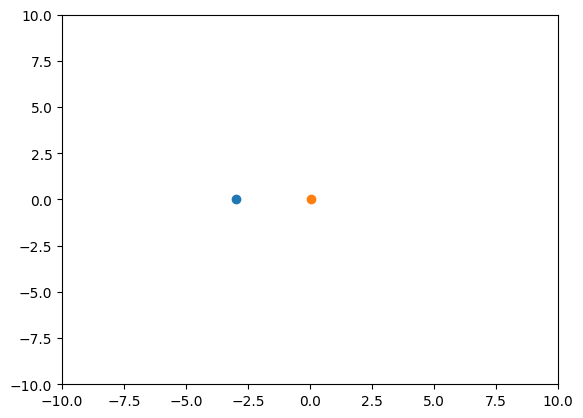

In [75]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
import math

class Particle:
    def __init__(self, name, mass, position, velocity=np.zeros(2), force=np.zeros(2)):
        self.mass = mass
        self.name = name
        self.position = np.array(position, dtype=float)
        self.force = force
        self.velocity = np.array(velocity, dtype=float)
        self.distance = self.calculate_distance()
        self.angle = self.calculate_angle()

    def calculate_distance(self):
        return np.linalg.norm(self.position)

    def calculate_angle(self):
        return math.atan2(self.position[1], self.position[0])

def calculate_center_of_mass(particles):
    total_mass = sum(p.mass for p in particles)
    center_of_mass = np.zeros(2)

    for p in particles:
        center_of_mass += p.position * p.mass

    center_of_mass /= total_mass

    max_mass_particle = max(particles, key=lambda p: p.mass)
    first_axis = max_mass_particle.position - center_of_mass
    first_axis /= np.linalg.norm(first_axis)
    second_axis = np.array([-first_axis[1], first_axis[0]])

    for p in particles:
        relative_position = p.position - center_of_mass
        p.position[0] = np.dot(relative_position, first_axis)
        p.position[1] = np.dot(relative_position, second_axis)

    return center_of_mass

def update_characteristics(particles, t, G=6.67430e-11):
    center_mass = calculate_center_of_mass(particles)
    for k in range(len(particles)):
        particles[k].force = np.zeros(2)

        for l in range(len(particles)):
            if l != k:
                r = particles[l].position - particles[k].position
                distance = np.linalg.norm(r)

                if distance < 0.1:
                    continue

                force_magnitude = (G * particles[k].mass * particles[l].mass) / (distance ** 2)
                force_direction = r / distance

                particles[k].force += force_magnitude * force_direction

        # Update angle and distance
        relative_position = particles[k].position - center_mass
        particles[k].angle = math.atan2(relative_position[1], relative_position[0])
        particles[k].distance = np.linalg.norm(relative_position)

        # Update velocity and position
        particles[k].velocity = np.sqrt(G * particles[1].mass / particles[k].distance) * np.array([-np.sin(particles[k].angle), np.cos(particles[k].angle)])
        particles[k].position[0] = particles[k].distance * np.cos(particles[k].angle)
        particles[k].position[1] = particles[k].distance * np.sin(particles[k].angle)

    # Update the position of the center of mass
    center_mass = calculate_center_of_mass(particles)

    return center_mass
# Initialize particles for the simulation
particle1 = Particle(name='Particle1', mass=1.0, position=[-0, 0], velocity=[0, 1])
particle2 = Particle(name='Particle2', mass=100.0, position=[3, 0], velocity=[0, 0])

# List of particles
particles = [particle1, particle2]

# Simulation parameters
dt = 0.1  # Time step

# Set up the figure and axis for the animation
fig, ax = plt.subplots()
ax.set_xlim(-10, 10)
ax.set_ylim(-10, 10)

# Create lines for each particle
lines = [ax.plot([], [], 'o')[0] for _ in particles]

# Initialization function for the animation
def init():
    for line in lines:
        line.set_data([], [])
    return lines

# Animation function
def animate(frame):
    for particle in particles:
        particle.force = np.zeros(2)
        update_characteristics(particles, dt)

    for particle in particles:
        acceleration = particle.force / particle.mass
        particle.velocity += acceleration * dt

    for particle in particles:
        particle.position[0] += particle.velocity[0] * dt
        particle.position[1] += particle.velocity[1] * dt

    for i, particle in enumerate(particles):
        x, y = particle.position
        lines[i].set_data(x, y)

    return lines

# Create the animation
ani = FuncAnimation(fig, animate, frames=100, init_func=init, blit=True)

# Display the animation
HTML(ani.to_jshtml())


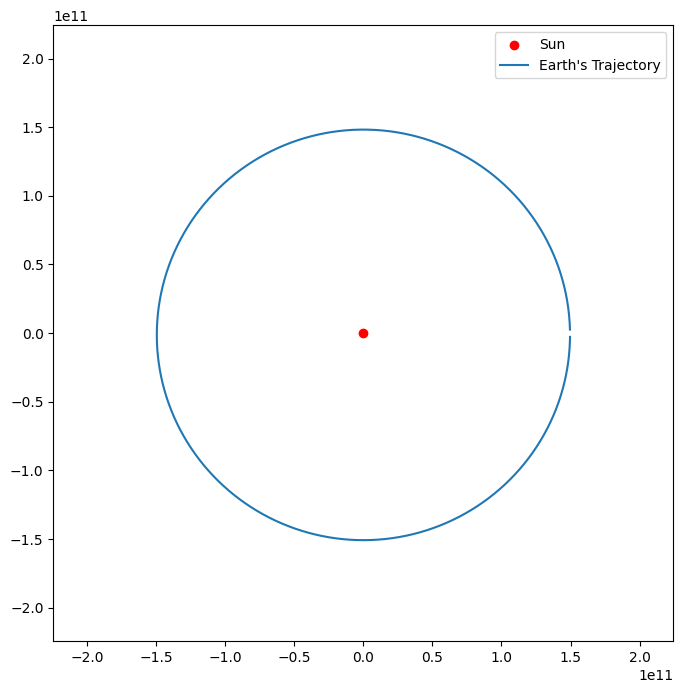

In [78]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Constants
G = 6.67430e-11  # Gravitational constant
m_sun = 1.989e30  # Mass of the Sun in kg
m_earth = 5.972e24  # Mass of the Earth in kg
AU = 1.496e11  # Astronomical Unit in meters

# Initial conditions
r_earth = np.array([AU, 0], dtype=float)  # Initial position of Earth (x, y)
v_earth = np.array([0, 29783], dtype=float)  # Initial velocity of Earth (vx, vy)

# Simulation parameters
dt = 60 * 60 * 24  # Time step in seconds (1 day)
num_steps = 365  # Simulate for 1 year

# Lists to store trajectory points
earth_trajectory = []

# Euler integration
for step in range(num_steps):
    # Compute gravitational force on Earth
    r = np.linalg.norm(r_earth)
    force_magnitude = (G * m_sun * m_earth) / (r ** 2)
    force_direction = -r_earth / r
    gravitational_force = force_magnitude * force_direction

    # Update Earth's velocity and position using Euler's method
    v_earth += (gravitational_force / m_earth) * dt
    r_earth += v_earth * dt

    # Store the trajectory point
    earth_trajectory.append(r_earth.copy())

# Extract x and y coordinates for plotting
x_earth = [point[0] for point in earth_trajectory]
y_earth = [point[1] for point in earth_trajectory]

# Function to update the plot in each animation frame
def update(frame, line):
    line.set_data(x_earth[:frame], y_earth[:frame])
    return line,

# Set up the figure and axis
fig, ax = plt.subplots(figsize=(8, 8))
ax.set_xlim(-1.5 * AU, 1.5 * AU)
ax.set_ylim(-1.5 * AU, 1.5 * AU)

# Plot the Sun
ax.scatter([0], [0], color='red', label='Sun')

# Plot the initial position of Earth
line, = ax.plot([], [], label="Earth's Trajectory")
ax.legend()

# Create the animation
ani = FuncAnimation(fig, update, frames=num_steps, fargs=(line,), blit=True)

# Display the animation as HTML
HTML(ani.to_jshtml())


<ipython-input-103-d9c8696c16c2>:63: MatplotlibDeprecationWarning: Setting data with a non sequence type is deprecated since 3.7 and will be remove two minor releases later
  point.set_data(x_orbiting, y_orbiting)


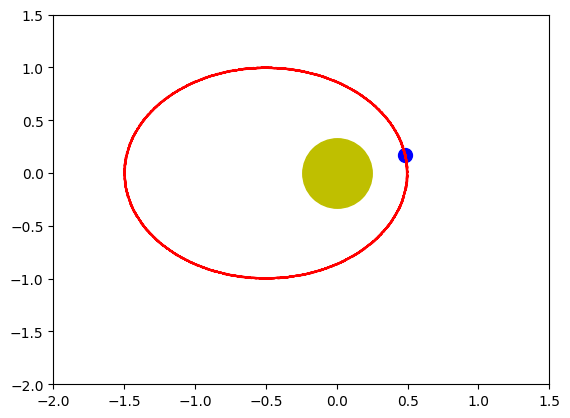

In [103]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Constants
G = 1.0  # Gravitational constant
m_central = 10.0  # Mass of the central body (e.g., Sun)
m_orbiting = 1.0  # Mass of the orbiting body (e.g., Earth)

# Initial conditions
a = 1.0  # Semi-major axis of the orbit
eccentricity = 0.5  # Eccentricity of the orbit
initial_angle = 0.0  # Initial angle

# Calculate initial position and velocity
initial_radius = a * (1 - eccentricity**2) / (1 + eccentricity * np.cos(np.radians(initial_angle)))
x_orbiting = initial_radius * np.cos(np.radians(initial_angle))
y_orbiting = initial_radius * np.sin(np.radians(initial_angle))

# Calculate initial velocity using vis-viva equation
v_orbiting = np.sqrt(G * m_central * ((2 / initial_radius) - (1 / a)))

# Calculate initial angular velocity
angular_velocity = v_orbiting / initial_radius

# Time step and number of frames
dt = 1
frames = 200

# Create a figure and axis
fig, ax = plt.subplots()
ax.set_xlim(-2, 1.5)
ax.set_ylim(-2, 1.5)

# Create a larger central particle (Sun)
central_particle, = ax.plot(0, 0, 'yo', markersize=50)

# Create a point (orbiting particle)
point, = ax.plot([], [], 'bo', markersize=10)

# Create a line for the trajectory
trajectory, = ax.plot([], [], 'r--')

# Initialization function for the animation
def init():
    point.set_data([], [])
    trajectory.set_data([], [])
    return point, trajectory,

# Animation function
def animate(frame):
    global x_orbiting, y_orbiting

    # Calculate the angle at this frame
    angle = initial_angle + angular_velocity * frame

    # Update position based on the calculated angle
    radius = a * (1 - eccentricity**2) / (1 + eccentricity * np.cos(np.radians(angle)))
    x_orbiting = radius * np.cos(np.radians(angle))
    y_orbiting = radius * np.sin(np.radians(angle))

    point.set_data(x_orbiting, y_orbiting)

    # Update trajectory
    angle_array = np.linspace(0, angle, frame)
    trajectory_x = a * np.cos(np.radians(angle_array)) + x_orbiting_central
    trajectory_y = a * np.sin(np.radians(angle_array)) + y_orbiting_central
    trajectory.set_data(trajectory_x, trajectory_y)

    return point, trajectory,

# Calculate the position of the central body (Sun) in the shifted coordinates
x_orbiting_central = -a * eccentricity
y_orbiting_central = 0.0

# Create the animation
ani = FuncAnimation(fig, animate, frames=frames, init_func=init, blit=True)

# Display the animation
HTML(ani.to_jshtml())



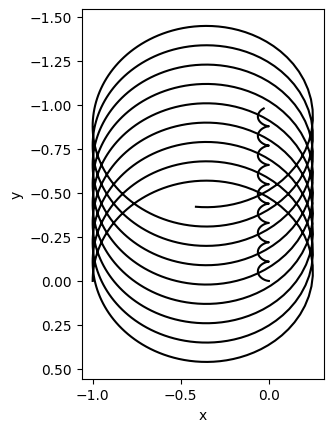

In [108]:
import matplotlib.pyplot as plt
from scipy.integrate import odeint
import numpy as np

def twobody(z, t):
    dz = np.zeros(8)
    G = 1.0
    m1 = 0.1
    m2 = 2.0

    r = ((z[0] - z[2]) ** 2 + (z[1] - z[3]) ** 2) ** (3 / 2)
    alpha = G / r

    dz[0] = z[4]
    dz[1] = z[5]
    dz[2] = z[6]
    dz[3] = z[7]
    dz[4] = alpha * m2 * (z[2] - z[0])
    dz[5] = alpha * m2 * (z[3] - z[1])
    dz[6] = alpha * m1 * (z[0] - z[2])
    dz[7] = alpha * m1 * (z[1] - z[3])

    return dz

# Initial conditions
z0 = [-1, 0, 0, 0, 0, -1, 0, 0]

# Time points
t = np.linspace(0, 20, 1000)

# Solve the ODE using odeint
z = odeint(twobody, z0, t)

# Plot the results with y-axis oriented vertically
plt.plot(z[:, 0], z[:, 1], 'k', z[:, 2], z[:, 3], 'k')
plt.xlabel('x')
plt.ylabel('y')
plt.gca().set_aspect('equal', adjustable='box')  # Set aspect ratio to 'equal'
plt.gca().invert_yaxis()  # Invert y-axis to have it vertical
plt.show()


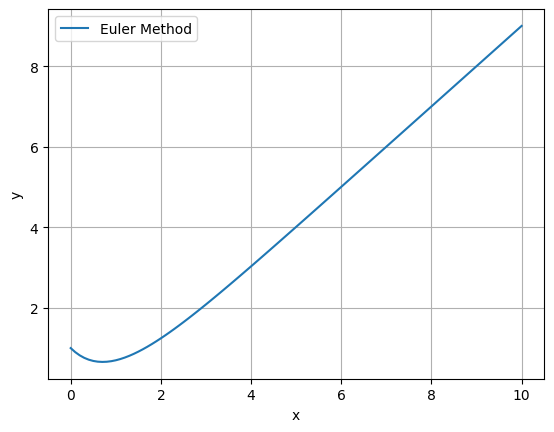

In [114]:
import numpy as np
import matplotlib.pyplot as plt

# Define the differential equation dy/dx = f(x, y)
def f(x, y):
    return x - y

# Euler method for numerical integration
def euler_method(f, x0, y0, h, num_steps):
    x_values = np.zeros(num_steps+1)
    y_values = np.zeros(num_steps+1)
    x_values[0] = x0
    y_values[0] = y0

    for i in range(num_steps):
        x = x_values[i]
        y = y_values[i]
        y_new = y + h * f(x, y)  # Euler's method formula
        x_values[i+1] = x + h
        y_values[i+1] = y_new

    return x_values, y_values

# Initial condition
x0 = 0.0
y0 = 1.0

# Parameters for numerical integration
h = 0.1  # Step size
num_steps = 100  # Number of steps

# Solve the ODE using Euler's method
x_values, y_values = euler_method(f, x0, y0, h, num_steps)

# Plot the results
plt.plot(x_values, y_values, label='Euler Method')
plt.xlabel('x')
plt.ylabel('y')
plt.legend()
plt.grid()
plt.show()


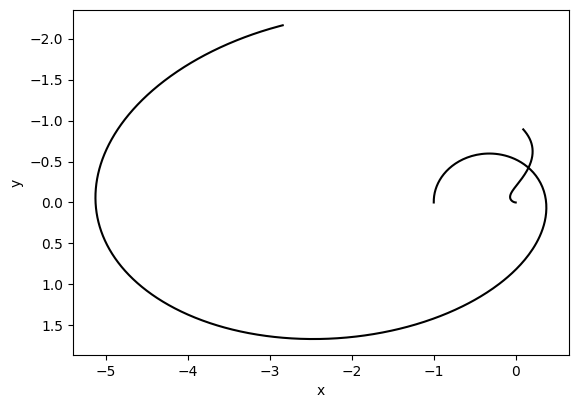

In [123]:
import numpy as np
import matplotlib.pyplot as plt

# Define the differential equation dz/dt = twobody(z, t)
def twobody(z):
    dz = np.zeros(8)
    G = 1.0
    m1 = 0.1
    m2 = 2.0

    r = ((z[0] - z[2]) ** 2 + (z[1] - z[3]) ** 2) ** (3 / 2)
    alpha = G / r

    dz[0] = z[4]
    dz[1] = z[5]
    dz[2] = z[6]
    dz[3] = z[7]
    dz[4] = alpha * m2 * (z[2] - z[0])
    dz[5] = alpha * m2 * (z[3] - z[1])
    dz[6] = alpha * m1 * (z[0] - z[2])
    dz[7] = alpha * m1 * (z[1] - z[3])

    return dz

# Euler method for numerical integration using twobody
def euler_method(twobody, z0, t):
    num_steps = len(t) - 1
    h_values = t[1:] - t[:-1]  # Calculate step sizes

    z_values = np.zeros((num_steps + 1, len(z0)))
    z_values[0] = z0

    for i in range(num_steps):
        z = z_values[i]
        dz = twobody(z)
        h = h_values[i]
        z_new = z + h * dz  # Euler's method formula
        z_values[i + 1] = z_new

    return z_values

# Initial conditions
z0 = np.array([-1, 0, 0, 0, 0, -1, 0, 0])

# Time points
t = np.linspace(0, 20, 1000)

# Solve the ODE using Euler's method
z_values = euler_method(twobody, z0, t)

# Plot the results with y-axis oriented vertically
plt.plot(z_values[:, 0], z_values[:, 1], 'k', z_values[:, 2], z_values[:, 3], 'k')
plt.xlabel('x')
plt.ylabel('y')
plt.gca().set_aspect('equal', adjustable='box')  # Set aspect ratio to 'equal'
plt.gca().invert_yaxis()  # Invert y-axis to have it vertical
plt.show()


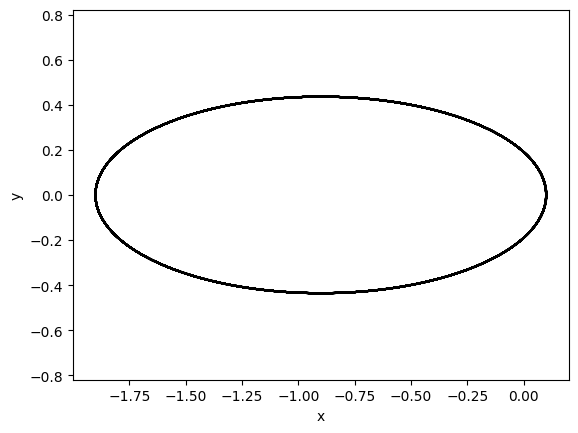

In [140]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.integrate import odeint

# Define the differential equation
def twobodyf(z, t):
    dz = np.zeros(4)
    GM = 1.0

    r = (z[0]**2 + z[1]**2)**(3/2)
    alpha = GM / r

    dz[0] = z[2]
    dz[1] = z[3]
    dz[2] = -alpha * z[0]
    dz[3] = -alpha * z[1]

    return dz

# Constants
e = 0.9
tspan = np.linspace(0, 100, 10000)

# Initial conditions
z0 = [1 - e, 0, 0, np.sqrt((1 + e) / (1 - e))]

# Solve the ODE
z = odeint(twobodyf, z0, tspan)

# Plot the results
plt.plot(z[:, 0], z[:, 1], 'k')
plt.xlabel('x')
plt.ylabel('y')
plt.axis('equal')
plt.show()


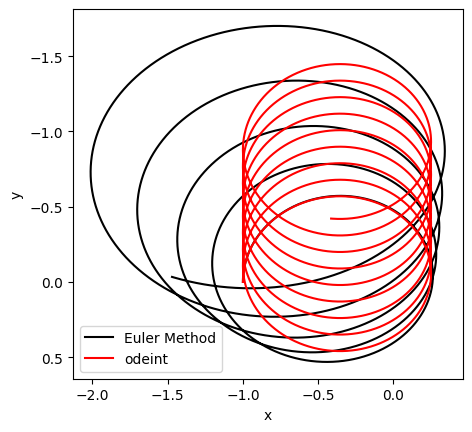

In [138]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.integrate import odeint

# Define the twobody function
def twobody(z, t, G, m1, m2):
    dz = np.zeros(8)

    r = ((z[0] - z[2]) ** 2 + (z[1] - z[3]) ** 2) ** (3 / 2)
    alpha = G / r

    dz[0] = z[4]
    dz[1] = z[5]
    dz[2] = z[6]
    dz[3] = z[7]
    dz[4] = alpha * m2 * (z[2] - z[0])
    dz[5] = alpha * m2 * (z[3] - z[1])
    dz[6] = alpha * m1 * (z[0] - z[2])
    dz[7] = alpha * m1 * (z[1] - z[3])

    return dz

# Euler method
def euler_method(func, z0, t):
    n = len(t)
    z = np.zeros((n, len(z0)))
    z[0] = z0

    for i in range(1, n):
        dt = t[i] - t[i-1]
        z[i] = z[i-1] + func(z[i-1], t[i-1]) * dt

    return z

# Parameters and initial conditions
G = 1.0
m1 = 0.1
m2 = 2.0
z0 = np.array([-1, 0, 0, 0, 0, -1, 0, 0])
t = np.linspace(0, 20, 10000)  # Smaller time step

# Calculate z using Euler method
z_euler = euler_method(lambda z, t: twobody(z, t, G, m1, m2), z0, t)

# Calculate z using odeint
z_odeint = odeint(lambda z, t: twobody(z, t, G, m1, m2), z0, t)

# Plot the results
plt.plot(z_euler[:, 0], z_euler[:, 1], 'k', label='Euler Method')
plt.plot(z_odeint[:, 0], z_odeint[:, 1], 'r', label='odeint')
plt.xlabel('x')
plt.ylabel('y')
plt.gca().set_aspect('equal', adjustable='box')
plt.gca().invert_yaxis()
plt.legend()
plt.show()


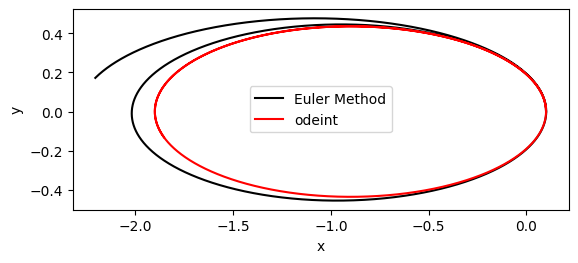

In [179]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.integrate import odeint

# Define the differential equation
def twobodyf(z, t):
    dz = np.zeros(4)
    GM = 1.0

    r = (z[0]**2 + z[1]**2)**(3/2)
    alpha = GM / r

    dz[0] = z[2]
    dz[1] = z[3]
    dz[2] = -alpha * z[0]
    dz[3] = -alpha * z[1]

    return dz

# Euler method
def euler_method(func, z0, t):
    n = len(t)
    z = np.zeros((n, len(z0)))
    z[0] = z0

    for i in range(1, n):
        dt = t[i] - t[i-1]
        z[i] = z[i-1] + func(z[i-1], t[i-1]) * dt
    return z




# Constants
e = 0.9
tspan = np.linspace(0, 10, 100000)

# Initial conditions
z0 = [1 - e, 0, 0, np.sqrt((1 + e) / (1 - e))]

# Calculate z using Euler method
z_euler = euler_method(twobodyf, z0, tspan)

# Calculate z using odeint
z_odeint = odeint(twobodyf, z0, tspan)

# Plot the results
plt.plot(z_euler[:, 0], z_euler[:, 1], 'k', label='Euler Method')
plt.plot(z_odeint[:, 0], z_odeint[:, 1], 'r', label='odeint')
plt.xlabel('x')
plt.ylabel('y')
plt.gca().set_aspect('equal', adjustable='box')
plt.legend()
plt.show()


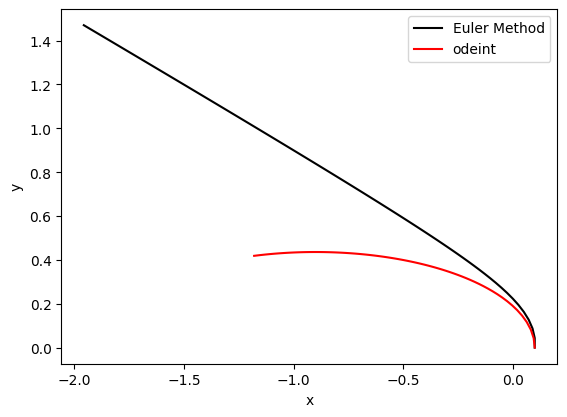

In [177]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.integrate import odeint


N = 1000  # Number of time steps
mu = 1.0  # Gravitational parameter (you can set it to the desired value)
h = 0.01  # Time step size (adjust as needed)

# Define the differential equation
def twobodyf(z, t):
    dz = np.zeros(4)
    GM = 1.0

    r = (z[0]**2 + z[1]**2)**(3/2)
    alpha = GM / r

    dz[0] = z[2]
    dz[1] = z[3]
    dz[2] = -alpha * z[0]
    dz[3] = -alpha * z[1]

    return dz

# Euler method
def euler_method(func, z0, t):
    n = len(t)
    z = np.zeros((n, len(z0)))
    z[0] = z0

    for i in range(1, n):
        alpha = mu / (z[i-1, 0]**2 + z[i-1, 1]**2)**(3/2)

        z[i, 2] = z[i-1, 2] - h * alpha * z[i-1, 0]
        z[i, 3] = z[i-1, 3] - h * alpha * z[i-1, 1]

        z[i, 0] = z[i-1, 0] + h * z[i-1, 2]
        z[i, 1] = z[i-1, 1] + h * z[i-1, 3]

        t[i] = t[i-1] + h

    return z



# Constants
e = 0.9
tspan = np.linspace(0, 1.0, 100)

# Initial conditions
z0 = [1 - e, 0, 0, np.sqrt((1 + e) / (1 - e))]

# Calculate z using Euler method
z_euler = euler_method(twobodyf, z0, tspan)

# Calculate z using odeint
z_odeint = odeint(twobodyf, z0, tspan)

# Plot the results
plt.plot(z_euler[:, 0], z_euler[:, 1], 'k', label='Euler Method')
plt.plot(z_odeint[:, 0], z_odeint[:, 1], 'r', label='odeint')
plt.xlabel('x')
plt.ylabel('y')
plt.gca().set_aspect('equal', adjustable='box')
plt.legend()
plt.show()

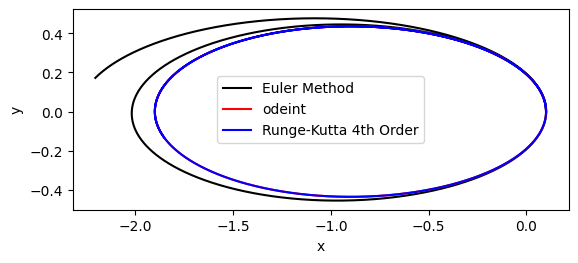

In [180]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.integrate import odeint

# Define the differential equation
def twobodyf(z, t):
    dz = np.zeros(4)
    GM = 1.0

    r = (z[0]**2 + z[1]**2)**(3/2)
    alpha = GM / r

    dz[0] = z[2]
    dz[1] = z[3]
    dz[2] = -alpha * z[0]
    dz[3] = -alpha * z[1]

    return dz

# Euler method
def euler_method(func, z0, t):
    n = len(t)
    z = np.zeros((n, len(z0)))
    z[0] = z0

    for i in range(1, n):
        dt = t[i] - t[i-1]
        z[i] = z[i-1] + func(z[i-1], t[i-1]) * dt
    return z

# Runge-Kutta 4th order method
def runge_kutta_4(func, z0, t):
    n = len(t)
    z = np.zeros((n, len(z0)))
    z[0] = z0

    for i in range(1, n):
        dt = t[i] - t[i-1]
        k1 = func(z[i-1], t[i-1])
        k2 = func(z[i-1] + 0.5 * dt * k1, t[i-1] + 0.5 * dt)
        k3 = func(z[i-1] + 0.5 * dt * k2, t[i-1] + 0.5 * dt)
        k4 = func(z[i-1] + dt * k3, t[i-1] + dt)
        z[i] = z[i-1] + (dt / 6.0) * (k1 + 2 * k2 + 2 * k3 + k4)
    return z

# Constants
e = 0.9
tspan = np.linspace(0, 10, 100000)

# Initial conditions
z0 = [1 - e, 0, 0, np.sqrt((1 + e) / (1 - e))]

# Calculate z using Euler method
z_euler = euler_method(twobodyf, z0, tspan)

# Calculate z using odeint
z_odeint = odeint(twobodyf, z0, tspan)

# Calculate z using Runge-Kutta 4th order method
z_rk4 = runge_kutta_4(twobodyf, z0, tspan)

# Plot the results
plt.plot(z_euler[:, 0], z_euler[:, 1], 'k', label='Euler Method')
plt.plot(z_odeint[:, 0], z_odeint[:, 1], 'r', label='odeint')
plt.plot(z_rk4[:, 0], z_rk4[:, 1], 'b', label='Runge-Kutta 4th Order')
plt.xlabel('x')
plt.ylabel('y')
plt.gca().set_aspect('equal', adjustable='box')
plt.legend()
plt.show()


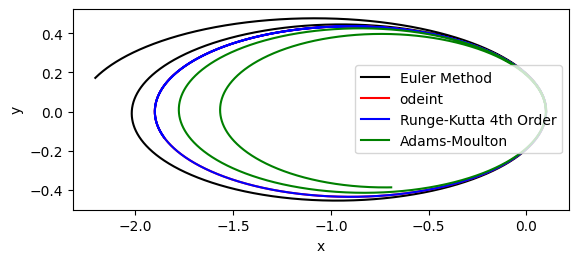

In [181]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.integrate import odeint

# Define the differential equation
def twobodyf(z, t):
    dz = np.zeros(4)
    GM = 1.0

    r = (z[0]**2 + z[1]**2)**(3/2)
    alpha = GM / r

    dz[0] = z[2]
    dz[1] = z[3]
    dz[2] = -alpha * z[0]
    dz[3] = -alpha * z[1]

    return dz

# Euler method
def euler_method(func, z0, t):
    n = len(t)
    z = np.zeros((n, len(z0)))
    z[0] = z0

    for i in range(1, n):
        dt = t[i] - t[i-1]
        z[i] = z[i-1] + func(z[i-1], t[i-1]) * dt
    return z

# Runge-Kutta 4th order method
def runge_kutta_4(func, z0, t):
    n = len(t)
    z = np.zeros((n, len(z0)))
    z[0] = z0

    for i in range(1, n):
        dt = t[i] - t[i-1]
        k1 = func(z[i-1], t[i-1])
        k2 = func(z[i-1] + 0.5 * dt * k1, t[i-1] + 0.5 * dt)
        k3 = func(z[i-1] + 0.5 * dt * k2, t[i-1] + 0.5 * dt)
        k4 = func(z[i-1] + dt * k3, t[i-1] + dt)
        z[i] = z[i-1] + (dt / 6.0) * (k1 + 2 * k2 + 2 * k3 + k4)
    return z

# Adams-Moulton method
def adams_moulton(func, z0, t):
    n = len(t)
    z = np.zeros((n, len(z0)))
    z[0] = z0

    for i in range(1, n):
        dt = t[i] - t[i-1]
        # Predictor using Runge-Kutta 4th order
        k1 = func(z[i-1], t[i-1])
        k2 = func(z[i-1] + 0.5 * dt * k1, t[i-1] + 0.5 * dt)
        k3 = func(z[i-1] + 0.5 * dt * k2, t[i-1] + 0.5 * dt)
        k4 = func(z[i-1] + dt * k3, t[i-1] + dt)
        predictor = z[i-1] + (dt / 6.0) * (k1 + 2 * k2 + 2 * k3 + k4)

        # Corrector using Adams-Moulton formula
        z[i] = z[i-1] + (dt / 24.0) * (9 * func(predictor, t[i]) + 19 * k4 - 5 * k3 + k2)

    return z

# Constants
e = 0.9
tspan = np.linspace(0, 10, 100000)

# Initial conditions
z0 = [1 - e, 0, 0, np.sqrt((1 + e) / (1 - e))]

# Calculate z using Euler method
z_euler = euler_method(twobodyf, z0, tspan)

# Calculate z using odeint
z_odeint = odeint(twobodyf, z0, tspan)

# Calculate z using Runge-Kutta 4th order method
z_rk4 = runge_kutta_4(twobodyf, z0, tspan)

# Calculate z using Adams-Moulton method
z_am = adams_moulton(twobodyf, z0, tspan)

# Plot the results
plt.plot(z_euler[:, 0], z_euler[:, 1], 'k', label='Euler Method')
plt.plot(z_odeint[:, 0], z_odeint[:, 1], 'r', label='odeint')
plt.plot(z_rk4[:, 0], z_rk4[:, 1], 'b', label='Runge-Kutta 4th Order')
plt.plot(z_am[:, 0], z_am[:, 1], 'g', label='Adams-Moulton')
plt.xlabel('x')
plt.ylabel('y')
plt.gca().set_aspect('equal', adjustable='box')
plt.legend()
plt.show()


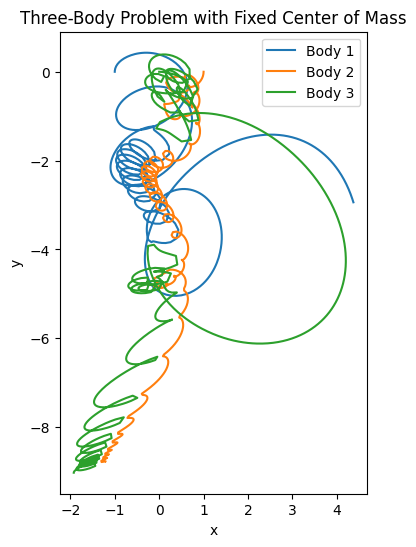

In [187]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.integrate import solve_ivp

# Define the system of differential equations for the three-body problem with different masses
def three_body_system(t, z, m1, m2, m3):
    x1, y1, x2, y2, x3, y3, vx1, vy1, vx2, vy2, vx3, vy3 = z

    # Gravitational constants
    G = 1.0

    # Distances between bodies
    r12 = np.sqrt((x1 - x2)**2 + (y1 - y2)**2)
    r13 = np.sqrt((x1 - x3)**2 + (y1 - y3)**2)
    r23 = np.sqrt((x2 - x3)**2 + (y2 - y3)**2)

    # System of differential equations
    dxdt = [vx1, vy1,
            vx2, vy2,
            vx3, vy3,
            G * ((m2 * (x2 - x1) / r12**3) + (m3 * (x3 - x1) / r13**3)),
            G * ((m2 * (y2 - y1) / r12**3) + (m3 * (y3 - y1) / r13**3)),
            G * ((m1 * (x1 - x2) / r12**3) + (m3 * (x3 - x2) / r23**3)),
            G * ((m1 * (y1 - y2) / r12**3) + (m3 * (y3 - y2) / r23**3)),
            G * ((m1 * (x1 - x3) / r13**3) + (m2 * (x2 - x3) / r23**3)),
            G * ((m1 * (y1 - y3) / r13**3) + (m2 * (y2 - y3) / r23**3))]

    return dxdt

# Time span
t_span = np.linspace(0, 50, 1000)

# Masses
m1 = 1.0  # Mass of body 1
m2 = 2.0  # Mass of body 2
m3 = 0.5  # Mass of body 3

# Calculate the center of mass
total_mass = m1 + m2 + m3
x_cm = (m1 * 0.0 + m2 * 1.0 + m3 * 0.0) / total_mass
y_cm = (m1 * 0.0 + m2 * 0.0 + m3 * 0.0) / total_mass

# Initial conditions and velocities to keep the center of mass at rest (fixed) at the origin
z0 = [-1.0 - x_cm, 0.0 - y_cm, 1.0 - x_cm, 0.0 - y_cm, 0.0 - x_cm, 0.0 - y_cm,
      0.0, 0.5, 0.0, -0.5, 0.0, 0.0]  # Initial positions and velocities

# Solve the system using Runge-Kutta 4th order method
sol = solve_ivp(three_body_system, [t_span[0], t_span[-1]], z0, args=(m1, m2, m3), t_eval=t_span, method='RK45')

# Plot the results
plt.figure(figsize=(10, 6))
plt.plot(sol.y[0] + x_cm, sol.y[1] + y_cm, label='Body 1')
plt.plot(sol.y[2] + x_cm, sol.y[3] + y_cm, label='Body 2')
plt.plot(sol.y[4] + x_cm, sol.y[5] + y_cm, label='Body 3')
plt.xlabel('x')
plt.ylabel('y')
plt.title('Three-Body Problem with Fixed Center of Mass')
plt.legend()
plt.gca().set_aspect('equal', adjustable='box')
plt.show()
